# About this file

this case study refers to the dataset coming from the Orlando Police Department records management system.

It includes all Part 1 and Part 2 crimes as defined by the FBI’s Uniform Crime Reporting standards. When multiple crimes are committed, the highest level of crime is what is shown.

The data includes only Open and Closed cases and does not include informational cases without arrests. This data excludes crimes where the victim or offender data is or could be legally protected.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import geopandas as gpd
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
from folium.plugins import FastMarkerCluster
import folium.plugins as plugins
import string
import random
import re
import datetime

In [2]:
df = pd.read_csv('../input/orlando-crimes/OPD_Crimes.csv')
df

,Case Number,Case Date Time,Case Location,Case Offense Location Type,Case Offense Category,Case Offense Type,Case Offense Charge Type,Case Disposition,Status,Location,Orlando Main Street Program Area,Orlando Commissioner Districts,Orlando Neighborhoods
0,2010-00800219,01/28/2010 12:47:00 PM,4100 Block of N ORANGE BLOSSOM TL,Construction Site,Theft,All other larceny,Committed,Closed,Unmapped,NaN,NaN,NaN,NaN
1,2010-00800220,01/28/2010 12:54:00 PM,4100 Block of N ORANGE BLOSSOM TL,Industrial/Mfg,Theft,All other larceny,Committed,Closed,Unmapped,NaN,NaN,NaN,NaN
2,2010-00800221,01/28/2010 01:02:00 PM,4100 Block of N ORANGE BLOSSOM TL,Industrial/Mfg,Theft,All other larceny,Committed,Closed,Unmapped,NaN,NaN,NaN,NaN
3,2010-00178297,04/16/2010 12:50:00 PM,4000 Block of N ORANGE BLOSSOM TL,Bus/Rail Terminal,Robbery,Robbery,Committed,Closed,Unmapped,NaN,NaN,NaN,NaN
4,2010-00193916,04/25/2010 06:41:00 PM,4800 Block of PHEASANT RUN DR,Residence/Single,Assault,Simple assault,Committed,Arrest,Unmapped,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181255,2014-00424233,10/11/2014 10:49:00 AM,5400 Block of S KIRKMAN RD,Restaurant/Fast Food,Theft,All other larceny,Committed,Closed,Mapped,"(28.48430627, -81.45885443)",NaN,5.0,14.0
181256,2013-00018215,01/13/2013 02:09:00 PM,3500 Block of E COLONIAL DR,Mall,Theft,Shoplifting,Committed,Closed,Mapped,"(28.55342308, -81.33947698)",NaN,4.0,121.0
181257,2011-00006598,01/05/2011 01:08:00 PM,5200 Block of STONE HARBOUR RD,Residence/Single,Burglary,Burglary/breaking and entering,Committed,Closed,Mapped,"(28.6063505, -81.44535972)",NaN,4.0,23.0
181258,2013-00074492,02/19/2013 03:59:00 PM,4800 Block of N PINE HILLS RD,Apartment/Condo,Burglary,Burglary/breaking and entering,Committed,Arrest,Mapped,"(28.60151209, -81.45152022)",NaN,NaN,NaN


In [3]:
df.isnull().sum()

Case Number                              0
Case Date Time                           2
Case Location                            0
Case Offense Location Type               0
Case Offense Category                    0
Case Offense Type                        0
Case Offense Charge Type                 0
Case Disposition                         0
Status                                   0
Location                              6892
Orlando Main Street Program Area    162374
Orlando Commissioner Districts       14553
Orlando Neighborhoods                14549
dtype: int64

In [4]:
df = df.dropna(axis = 0)

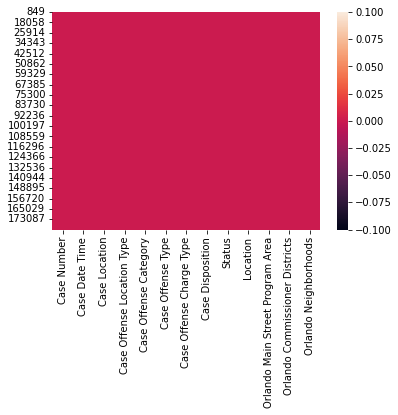

In [5]:
sns.heatmap(df.isnull());

In [6]:
df.describe()

,Orlando Main Street Program Area,Orlando Commissioner Districts,Orlando Neighborhoods
count,18886.000000,18886.000000,18886.000000
mean,6.166790,2.198877,70.570793
std,2.021838,1.469611,31.635836
min,1.000000,1.000000,3.000000
25%,5.000000,1.000000,41.000000
50%,7.000000,2.000000,75.000000
75%,7.000000,3.000000,103.000000
max,8.000000,6.000000,122.000000


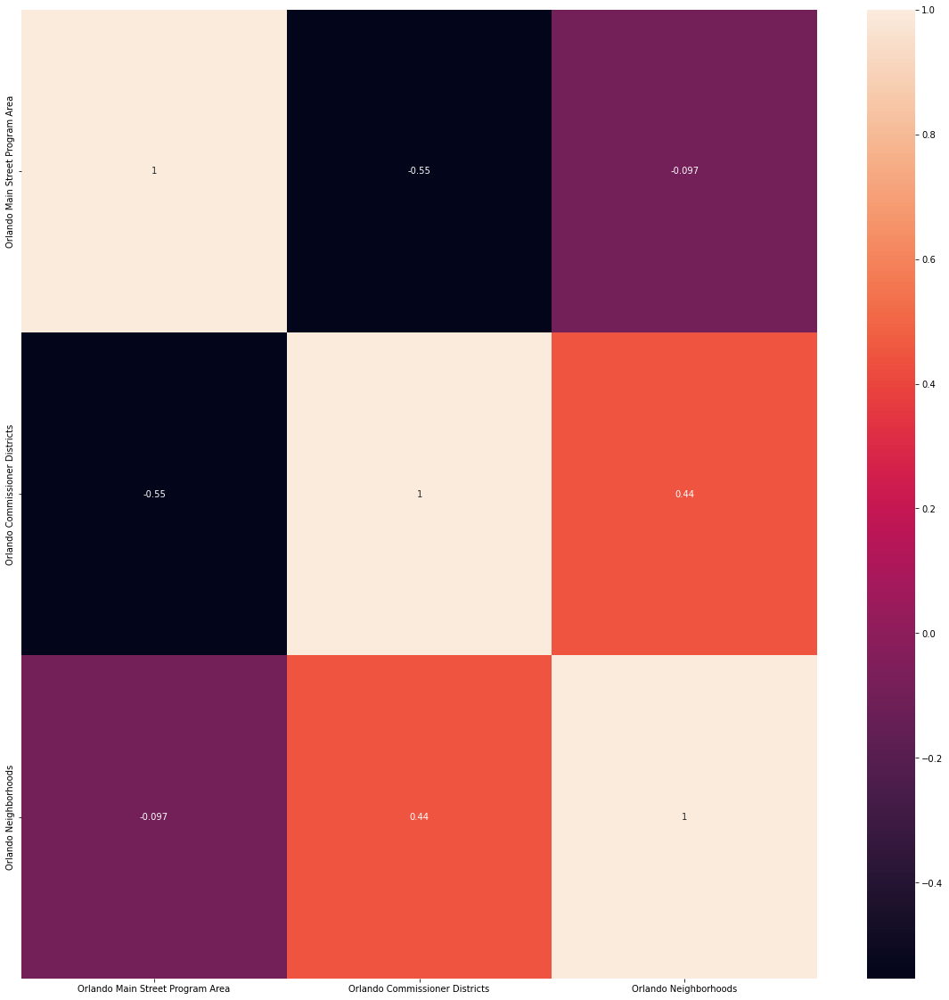

In [7]:
correlations = df.corr()
f, ax = plt.subplots(figsize = (20,20))
sns.heatmap(correlations, annot=True)
correlations.round(2);

# Graphics with raw data

In [8]:
fig1 = px.histogram(df,x='Case Offense Category',color='Case Offense Category',template='plotly_dark')
fig1.show()

In [9]:
fig1 = px.histogram(df,x='Case Offense Location Type',color='Case Offense Location Type',template='plotly_dark')
fig1.show()

In [10]:
fig1 = px.histogram(df,x='Case Offense Type',color='Case Offense Type',template='plotly_dark')
fig1.show()

In [11]:
fig1 = px.histogram(df,x='Case Offense Charge Type',color='Case Offense Charge Type',template='plotly_dark')
fig1.show()

In [12]:
fig1 = px.histogram(df,x='Case Disposition',color='Case Disposition',template='plotly_dark')
fig1.show()

In [13]:
df[['latitude', 'longitude']] = df['Location'].str.split(',', expand=True)

/opt/conda/lib/python3.7/site-packages/pandas/core/frame.py:3636: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [14]:
df1 = df['latitude'].str.split('(', expand=True)
df1 = df1.rename(columns = {1 : 'latitude'})
df1 = df1.drop(columns=[0], axis=1) 
df2 = df['longitude'].str.split(')', expand=True)
df2 = df2.rename(columns = {0 : 'longitude'})
df2 = df2.drop(columns=[1], axis=1) 
df = df.drop(df.columns[[0, 9, 13, 14]], axis=1)
df = pd.concat([df, df1, df2], axis = 1)

In [15]:
#df = df.drop(df.columns[[13,14]], axis=1)df
df

,Case Date Time,Case Location,Case Offense Location Type,Case Offense Category,Case Offense Type,Case Offense Charge Type,Case Disposition,Status,Orlando Main Street Program Area,Orlando Commissioner Districts,Orlando Neighborhoods,latitude,longitude
849,07/05/2011 09:56:00 AM,1200 Block of WEBER ST,Bank/Financial Institution,Fraud,False pretense/swindle/confidence game,Committed,Closed,Mapped,2.0,2.0,33.0,28.55857439,-81.36394364
922,03/20/2013 04:12:00 PM,4900 Block of WHALERS WAY,Residence/Single,Theft,All other larceny,Committed,Closed,Mapped,7.0,1.0,41.0,28.49298011,-81.30925419
1034,04/08/2015 10:11:00 AM,1200 Block of WEBER ST,Bank/Financial Institution,Fraud,False pretense/swindle/confidence game,Committed,Inactive,Mapped,2.0,2.0,33.0,28.55857439,-81.36394364
1182,06/19/2015 01:29:00 PM,1200 Block of WEBER ST,Bank/Financial Institution,Fraud,False pretense/swindle/confidence game,Committed,Closed,Mapped,2.0,2.0,33.0,28.55857439,-81.36394364
1485,03/02/2016 10:04:00 AM,1200 Block of WEBER ST,Bank/Financial Institution,Fraud,Credit card/atm fraud,Committed,Closed,Mapped,2.0,2.0,33.0,28.55857439,-81.36394364
...,...,...,...,...,...,...,...,...,...,...,...,...,...
181210,08/01/2010 04:00:00 PM,5500 Block of S SEMORAN BV,Auto Repair Shop,Theft,Theft from motor vehicle except parts/accessories,Committed,Closed,Mapped,7.0,1.0,36.0,28.48282291,-81.31013474
181215,02/06/2012 07:41:00 PM,3800 Block of S SEMORAN BV,Department/Discount Store,Theft,Shoplifting,Committed,Arrest,Mapped,7.0,1.0,41.0,28.50491395,-81.31026445
181217,10/22/2012 01:10:00 PM,100 Block of W GRANT ST,Department/Discount Store,Theft,All other larceny,Committed,Closed,Mapped,8.0,2.0,75.0,28.5165664,-81.37796233
181222,04/02/2011 03:55:00 PM,5700 Block of LA COSTA DR,Commercial/Office Building,Theft,Theft from motor vehicle except parts/accessories,Committed,Closed,Mapped,7.0,1.0,53.0,28.52789868,-81.30912395


In [16]:
df = df.rename(columns = {'Case Offense Category' : 'occurrence', 'Case Date Time' : 'date' })

(0.0, 12182.500000000002)

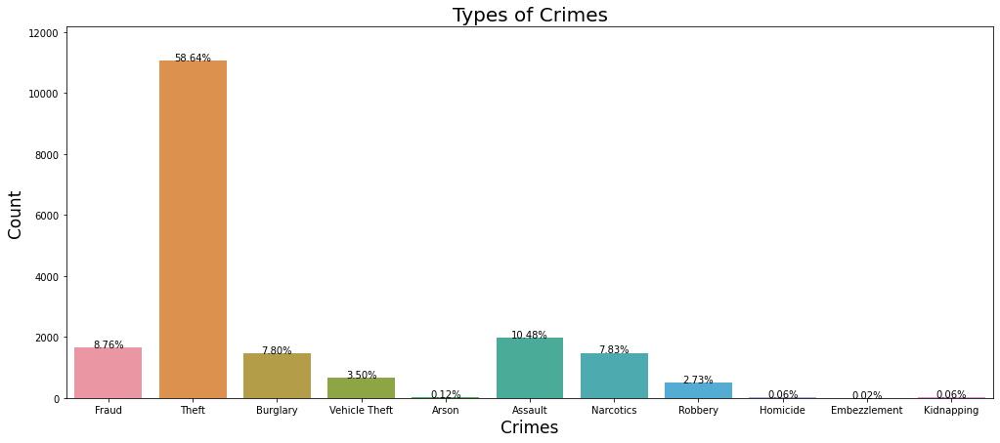

In [17]:
total = len(df)
ax1 = plt.figure(figsize=(17,7))

g = sns.countplot(x='occurrence', data=df)
g.set_title("Types of Crimes", fontsize=20)
g.set_xlabel("Crimes", fontsize=17)
g.set_ylabel("Count", fontsize=17)
sizes = []
for p in g.patches:
    height = p.get_height()
    sizes.append(height)
    g.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}%'.format(height/total*100),
            ha="center", fontsize=10) 
g.set_ylim(0, max(sizes) * 1.1)

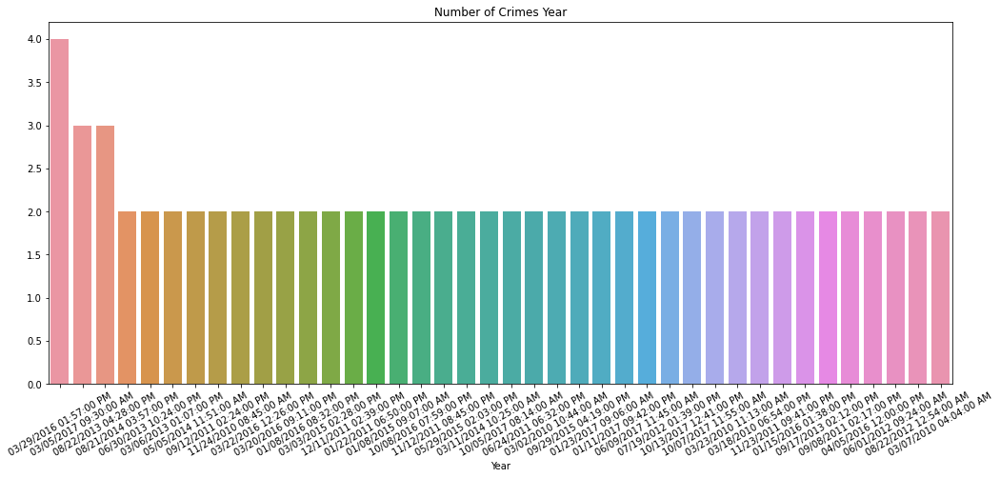

In [18]:
pl3 = plt.figure(figsize=(17,7))
pl3 = year = df.groupby('date')['occurrence'].count().sort_values(ascending=False).head(40)
pl3 = sns.barplot(x=year.index, y=year.values)
pl3 = plt.xticks(rotation=30)
pl3 = plt.xlabel('Year')
pl3 = plt.title('Number of Crimes Year');
pl3 = plt.show()

# Number of occurrences

In [19]:
temp = df.groupby('occurrence').sum()
temp.style.background_gradient(cmap='Purples')

,Orlando Main Street Program Area,Orlando Commissioner Districts,Orlando Neighborhoods
occurrence,,,
Arson,133.000000,53.000000,1452.000000
Assault,11333.000000,5784.000000,151572.000000
Burglary,9044.000000,3125.000000,98378.000000
Embezzlement,21.000000,12.000000,370.000000
Fraud,10600.000000,3043.000000,119688.000000
Homicide,78.000000,19.000000,772.000000
Kidnapping,74.000000,24.000000,882.000000
Narcotics,9562.000000,2850.000000,98865.000000
Robbery,3283.000000,1050.000000,35795.000000


In [20]:
temp = df.groupby('Case Offense Location Type').sum()
temp.style.background_gradient(cmap='Purples')

,Orlando Main Street Program Area,Orlando Commissioner Districts,Orlando Neighborhoods
Case Offense Location Type,,,
ATM/Depository,280.000000,91.000000,3253.000000
Airport,90.000000,35.000000,1300.000000
Antique Store,30.000000,38.000000,1092.000000
Apartment/Condo,14372.000000,3668.000000,114989.000000
Arcade/Game Room,7.000000,1.000000,41.000000
Arena/Stadium,671.000000,800.000000,10880.000000
Auto Dealer/Car Lot,1138.000000,253.000000,18265.000000
Auto Parts Store,132.000000,42.000000,1694.000000
Auto Repair Shop,431.000000,145.000000,4368.000000


# Occurrence Mapping

In [21]:
map_1 = folium.Map(location=[28.547690, -81.376366], tiles='cartodbpositron', zoom_start=12)
HeatMap(data=df[['latitude', 'longitude']], radius=10).add_to(map_1)
map_1

In [22]:
f = folium.Figure(width=1200, height=750)
map = folium.Map(location = [28.547690, -81.376366], 
                      zoom_start = 12).add_to(f)
price=folium.map.FeatureGroup()
price=plugins.MarkerCluster().add_to(map)
for latitude,longitude,label in zip(df.latitude,df.longitude,df.occurrence):
    folium.Marker(location=[latitude,longitude],icon=None,popup=label).add_to(price)
map.add_child(price)
map

**It is a very interesting database and rich in information, from the description of the coordinates I believe that it is only listed the crimes in the central region of Orlando and it does not include the surrounding districts, which leaves a little scared by the amount of crimes and crimes in the region.***

***We could continue exploring this data further, but we may already have a knowledge of the data in this dataset.***

***Thanks!!***

# ***If you find this notebook useful, support with an upvote*** 👍